---
---

# **`CGM - Assignment` : Predicting Height of the Children 👧👦📏** 

- Malnutrition is a global health crisis and is a leading cause of death among children under 5 years. 

- Detecting malnutrition requires `anthropometric measurements` of weight, height, and middle-upper arm circumference. 
    - Anthropometric measurements are a non invasive, inexpensive, and suitable method for `evaluating the nutritional status` in the samples.
    - However, anthropometric techniques are `prone to errors` that could arise, for example, from the inadequate training of personnel.


- Therefore, using a CNN-based deep learning model can certainly help in faster, easier and more precised collection of such measurements.


---
---

## **`Examples of various measurements` are shown below:**
![img_1](E:\STUDY\PROJECTS\Assignment_CGM\Doc_Images\Anthropometric_Measurements.png)


---
---


## **`NOTEBOOK Description` 📗**

- This notebook contains the below tasks:
    - `Image Augmentations`
        - Performed the various image augmentation techniques:
            - to increase the dataset count, and
            - to introduce the variablity & real-time scenario 
    - `Models Experimentation`
        - A : ResNet-50 : Fine Tuning + (Last 3 layers + Custom Top) with pre-trained ImageNet Weights 
        - B : ResNet-50 : Fine Tuning + (Custom Top) with pre-trained ImageNet Weights
        - C : RF Regressor on ResNet-50 Features
        - D : SVM Regressor on TOP & BOTTOM Distances Features

## **`NOTEBOOK Contents` ✍️**

[1. Libraries Import](#Import_Libraries)

[2. Dataset Import](#Dataset_Import)

##### ⭐ **`Image Augmentations`**

[3. How Image Augmentation provide us the better & bigger dataset❓](#Image_Augmentation)

##### ⭐ **`Performance Metrics`**

[4. Defining Performance Metrics](#Defining_Performance_Metrics)

##### ⭐ **`Models Strategies`**

[🧮 A. Fine_Tuning -- Last_3_Layers + Custom_TopLayers -- ImageNet Weights](#A.Fine_Tuning---Last_3_Layers__+__Custom_TopLayers---ImageNet_Weights)

[🧮 B. Fine Tuning -- Custom TopLayers -- ImageNet Weights](#B.Fine_Tuning---Custom_TopLayers---ImageNet_Weights)

[🧮 C. DL FEATURES -- ML Regressor Model](#C.DL_FEATURES---ML_Regressor_Model)

[🧮 D. TOP & BOTTOM Distance Features -- ML Regressor Model](#D.TOP_and_BOTTOM_DistanceFeatures---ML_Regressor_Model)


[⭐ **`SUMMARY`**](#SUMMARY)

## Import_Libraries

In [1]:
import os
import sys
import math
import scipy as scipy
import numpy as np
from numpy import arange
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import ast
import pathlib

import plotly.express as px
import plotly.graph_objects as go
import hashlib
from IPython.display import display
from PIL import Image
from tqdm import tqdm
tqdm.pandas()

%matplotlib inline

In [2]:
# Setting the display option
pd.set_option('display.max_columns', 50)

# Defining the variables for better plotting 
label_font_dict = {'family':'sans-serif','size':13.5,'color':'brown','style':'italic'}
title_font_dict = {'family':'sans-serif','size':17.5,'color':'Blue','style':'italic'}

## **Dataset_Import**

In [3]:
!pip install tensorflow-addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 30.7 MB/s 


In [4]:
## TRAIN set files
!gdown 1kuGJodL48MaAb57j2VSbSX_qXellGrBC
!gdown 1NAwb73kvK_uut71vNIte34tiaDKfSmTZ

Downloading...
From: https://drive.google.com/uc?id=1kuGJodL48MaAb57j2VSbSX_qXellGrBC
To: /content/Dataset.zip
100% 203k/203k [00:00<00:00, 110MB/s]
Downloading...
From: https://drive.google.com/uc?id=1NAwb73kvK_uut71vNIte34tiaDKfSmTZ
To: /content/HP_data_engg.csv
100% 3.55k/3.55k [00:00<00:00, 6.40MB/s]


In [5]:
!unzip Dataset.zip

Archive:  Dataset.zip
  inflating: Dataset/1d5fee00-ada4-11eb-a80b-3f50af21830f.jpg  
  inflating: Dataset/1eddf4c0-ad9f-11eb-a80b-ef4adba049aa.jpg  
  inflating: Dataset/38e29bc0-8fc0-11eb-b5f2-0742da91b282.jpg  
  inflating: Dataset/6cd5d480-8b8b-11eb-b152-f7b115384fa9.jpg  
  inflating: Dataset/76ed6fc0-8e1d-11eb-ad70-7be1a1219834.jpg  
  inflating: Dataset/8d23fa60-9201-11eb-b3e6-cbfb48c6a300.jpg  
  inflating: Dataset/9dc3eba0-8d8d-11eb-8d3f-4776be867c61.jpg  
  inflating: Dataset/9dd020a0-8d8d-11eb-8d3f-bfd9f6bd04d4.jpg  
  inflating: Dataset/d3757800-8dff-11eb-a328-472d4f8db277.jpg  


In [6]:
# Storing the location of the 'height_and_pose' file
hp_df = pd.read_csv(os.path.join(os.getcwd(), "HP_data_engg.csv"), index_col="Unnamed: 0")
hp_df['Img_name'] = hp_df['Img_name'].apply(lambda name: os.path.join(os.path.join(os.getcwd(), "Dataset"), name+".jpg"))
hp_df

,Img_name,nose_top_dist,nose_bottom_dist,left_eye_top_dist,left_eye_bottom_dist,right_eye_top_dist,right_eye_bottom_dist,left_ear_top_dist,left_ear_bottom_dist,right_ear_top_dist,right_ear_bottom_dist,left_shoulder_top_dist,left_shoulder_bottom_dist,right_shoulder_top_dist,right_shoulder_bottom_dist,left_elbow_top_dist,left_elbow_bottom_dist,right_elbow_top_dist,right_elbow_bottom_dist,left_wrist_top_dist,left_wrist_bottom_dist,right_wrist_top_dist,right_wrist_bottom_dist,left_hip_top_dist,left_hip_bottom_dist,right_hip_top_dist,right_hip_bottom_dist,left_knee_top_dist,left_knee_bottom_dist,right_knee_top_dist,right_knee_bottom_dist,left_ankle_top_dist,left_ankle_bottom_dist,right_ankle_top_dist,right_ankle_bottom_dist,Height
0,/content/Dataset/1d5fee00-ada4-11eb-a80b-3f50a...,139.691,453.810,151.440,460.771,113.032,476.286,180.259,445.126,101.246,478.053,224.946,388.402,163.677,412.205,291.861,332.618,218.935,368.847,319.802,276.817,235.590,342.005,352.147,229.775,330.627,247.948,457.988,118.041,400.249,210.554,426.089,152.056,458.407,194.857,76.7
1,/content/Dataset/1eddf4c0-ad9f-11eb-a80b-ef4ad...,219.240,376.907,107.062,464.210,208.241,395.238,139.040,432.574,202.198,386.158,170.682,399.706,237.697,349.583,130.723,440.394,287.228,340.067,95.316,481.054,291.823,375.793,306.436,272.108,332.235,238.045,374.111,226.972,393.302,177.855,447.702,165.827,464.532,105.850,66.4
2,/content/Dataset/38e29bc0-8fc0-11eb-b5f2-0742d...,114.684,464.978,121.393,460.750,209.028,415.961,139.339,438.516,210.612,412.764,180.103,396.358,244.709,353.241,117.177,462.027,254.459,392.036,107.047,483.412,254.249,442.271,334.531,250.052,365.415,211.029,409.651,202.716,429.890,146.674,489.473,148.322,489.456,103.502,63.2
3,/content/Dataset/6cd5d480-8b8b-11eb-b152-f7b11...,150.096,505.597,155.437,516.805,127.744,524.638,185.402,504.764,125.420,520.907,242.182,436.003,178.191,464.880,308.353,359.789,245.235,406.229,362.151,296.329,311.701,352.524,369.434,274.015,348.848,301.257,464.828,182.184,445.466,225.565,543.030,128.115,531.762,177.651,87.1
4,/content/Dataset/76ed6fc0-8e1d-11eb-ad70-7be1a...,91.655,500.699,88.932,502.501,89.834,501.079,122.090,470.116,167.362,470.016,160.697,430.627,194.623,439.693,129.537,468.497,212.710,471.281,84.680,507.193,183.968,515.070,308.260,285.770,327.234,268.397,381.836,239.404,422.678,168.536,479.981,165.535,507.097,90.993,59.1
5,/content/Dataset/8d23fa60-9201-11eb-b3e6-cbfb4...,190.423,472.569,179.159,487.789,172.724,488.188,131.322,488.105,136.639,483.716,169.193,435.949,209.694,408.771,239.258,375.096,310.914,304.460,271.681,333.434,289.150,337.040,329.403,282.248,353.680,251.499,447.742,172.448,467.127,140.664,547.518,117.861,567.176,64.311,86.4
6,/content/Dataset/9dc3eba0-8d8d-11eb-8d3f-4776b...,142.212,458.133,136.621,473.452,116.796,480.265,155.741,472.965,103.867,489.563,221.702,394.308,180.226,415.960,300.493,308.431,263.732,342.875,364.402,238.180,337.507,279.494,329.515,265.448,312.568,285.209,422.124,171.750,414.752,195.807,488.571,113.838,492.155,138.798,100.6
7,/content/Dataset/9dd020a0-8d8d-11eb-8d3f-bfd9f...,118.411,437.884,110.964,454.636,96.762,457.973,135.269,443.555,101.644,451.652,199.977,375.700,158.455,396.762,280.915,285.278,247.099,316.309,344.566,216.070,329.922,244.375,325.652,228.244,312.485,246.740,409.378,146.260,405.849,163.278,479.062,91.341,475.298,110.771,106.1
8,/content/Dataset/d3757800-8dff-11eb-a328-472d4...,179.026,501.837,174.395,509.670,176.691,516.647,111.132,530.799,170.003,517.505,173.186,468.816,238.792,433.049,277.820,377.785,333.128,325.585,348.933,315.665,400.402,253.969,354.905,290.880,378.720,261.624,464.386,197.124,471.840,167.764,571.270,159.135,583.359,62.913,99.9


In [7]:
hp_df.shape

(9, 36)

## **`Data_Preparation`**

In [8]:
import random as rn
import datetime
import time
import tensorflow as tf
import tensorflow_addons as tfa
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input, Dropout, BatchNormalization, Activation, Flatten, Conv1D, Conv2D, Concatenate, Lambda
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import MaxPool1D, MaxPool2D, GlobalAveragePooling1D, GlobalAveragePooling2D, AveragePooling1D, AveragePooling2D, SpatialDropout2D
from keras.regularizers import l1, l2
from keras.preprocessing import image
from keras.callbacks import Callback
from keras.callbacks import TensorBoard
from sklearn.metrics import accuracy_score, recall_score, f1_score, precision_score, roc_auc_score, confusion_matrix
from tensorboard import notebook
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

In [9]:
# All train images paths
all_train_paths = hp_df['Img_name'].values

# All train images tgt values
all_train_labels = np.float32(hp_df['Height'].values)

# Train and Validation Split
train_paths, valid_paths, train_labels, valid_labels = train_test_split(all_train_paths, 
                                                                        all_train_labels, 
                                                                        test_size=0.20, 
                                                                        random_state=2022)

In [10]:
# Checking shapes of all images paths and tgt values
all_train_paths.shape, all_train_labels.shape

((9,), (9,))

In [11]:
# Checking shapes of all TRAIN & VALIDATON images paths and tgt values
train_paths.shape, train_labels.shape, valid_paths.shape, valid_labels.shape

((7,), (7,), (2,), (2,))

##### **Reading the images**

In [12]:
# Function to read all the images
def reading_images(imgs_paths, size=(448,448)):
    """
    Description : This function will read all the given images and store them in a list.
    """
    # List container for storing all the images after reading, resizing & normalization
    images = []
    for index, img_path in enumerate(imgs_paths):
        # Reading the image
        img = cv2.imread(img_path)
        
        # Changing the color to RGB model
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        # Resizing the image
        img = cv2.resize(img, size)
        
        # Normalizing the pixel values
        img = img / 255.0
        
        # Storing every image
        images.append(img)
    return images

In [13]:
# Checking the train images paths
train_paths

array(['/content/Dataset/76ed6fc0-8e1d-11eb-ad70-7be1a1219834.jpg',
       '/content/Dataset/38e29bc0-8fc0-11eb-b5f2-0742da91b282.jpg',
       '/content/Dataset/8d23fa60-9201-11eb-b3e6-cbfb48c6a300.jpg',
       '/content/Dataset/d3757800-8dff-11eb-a328-472d4f8db277.jpg',
       '/content/Dataset/9dd020a0-8d8d-11eb-8d3f-bfd9f6bd04d4.jpg',
       '/content/Dataset/1eddf4c0-ad9f-11eb-a80b-ef4adba049aa.jpg',
       '/content/Dataset/1d5fee00-ada4-11eb-a80b-3f50af21830f.jpg'],
      dtype=object)

In [14]:
# Reading all the TRAIN images in a single list
all_train_images = reading_images(imgs_paths=train_paths)

# Matching the count of existing TRAIN images before-after reading them
print("### Total TRAIN Images & Labels available after splitting are  ===>  {} and {} ###".format(len(all_train_images),
                                                                                                   train_labels.shape[0]))

### Total TRAIN Images & Labels available after splitting are  ===>  7 and 7 ###


In [15]:
# Checking the shape of train image after reading it
print("### The shape of train image after reading it is  ===>   {}   ###".format(all_train_images[0].shape))

### The shape of train image after reading it is  ===>   (448, 448, 3)   ###


In [16]:
# Reading all the TEST images in a single list
all_test_images = reading_images(imgs_paths=valid_paths)

# Matching the count of existing TEST images before-after reading them
print("### Total TEST Images & Labels available after splitting are  ===>  {} and {} ###".format(len(all_test_images),
                                                                                                   valid_labels.shape[0]))

### Total TEST Images & Labels available after splitting are  ===>  2 and 2 ###


In [17]:
# Checking the shape of test image after reading it
print("### The shape of test image after reading it is  ===>   {}   ###".format(all_test_images[0].shape))

### The shape of test image after reading it is  ===>   (448, 448, 3)   ###


In [18]:
# Storing X_test and y_test for evaluation of models
X_test = np.asarray(all_test_images)
y_test = valid_labels

# Checking the dtype & shape of test set after reading it
print("### The dtype & shape of test set after reading it is  ===>   {}, {}, {}, {}  ###".format(type(X_test), type(y_test), X_test.shape, y_test.shape))

### The dtype & shape of test set after reading it is  ===>   <class 'numpy.ndarray'>, <class 'numpy.ndarray'>, (2, 448, 448, 3), (2,)  ###


In [19]:
# Checking the shape of the tgt values
valid_labels.shape

(2,)

In [20]:
# Defining the directory for storing the augmented images
aug_imgs_path = pathlib.Path(os.path.join(os.path.join(os.getcwd(),"Dataset"), "Augmented_Images"))
aug_imgs_path

PosixPath('/content/Dataset/Augmented_Images')

In [21]:
# Creating the folder in the drive for storing the Augmented Images
if "Augmented_Images" not in os.listdir(os.path.join(os.getcwd(),"Dataset")):
    os.mkdir(aug_imgs_path)
else:
    None

##### **Image Data Generator**

In [22]:
def data_augmentation(image):
    """
    Description : This function is created for performing the augmentations on an image to yield a different image.
    
    Inputs : It accepts below parameter:
        - img_name : Image name
    
    Returns : It returns the tensor object of an augmented image.
    """     
    # Adjusting the hue of the RGB image
    image = tf.image.adjust_hue(image, delta=0.02)
    
    # Adjusting the Brightness of the RGB image
    image = tf.image.adjust_brightness(image, delta=0.05)
   
    # Reducing the noise using Gaussian filter
    image = tfa.image.gaussian_filter2d(image, filter_shape=(12,12))
       
    return image

In [23]:
# Defining the IMAGE DATA GENERATOR for only the TRAIN SET
train_img_gen = tf.keras.preprocessing.image.ImageDataGenerator(rotation_range=0.3, 
                                                                zoom_range=0.08,
                                                                horizontal_flip=True, 
                                                                vertical_flip=False, 
                                                                shear_range=0.25, 
                                                                width_shift_range=0.15,
                                                                height_shift_range=0.15,
                                                                preprocessing_function=data_augmentation,
                                                                rescale=None)

## **`Image_Augmentation`**

In [24]:
def generate_aug_images(readed_images, labels, data_gen, aug_img_dir, size=(448,448), no_of_aug_images=9):
    """
    Description : This function is created for generating & storing(both in-drive & memory) the augmented images.
    """
    images_after_aug = []
    labels_after_aug = []
    for index, image in enumerate(readed_images):
        for i in range(no_of_aug_images):
            img = data_gen.flow(x=np.reshape(image, (1, size[0], size[1], 3)), 
                                  batch_size=32,
                                  shuffle=True,
                                  sample_weight=None,
                                  save_to_dir=aug_imgs_path,
                                  save_prefix="Aug_Train",
                                  save_format='jpg').next()
            images_after_aug.append(np.reshape(img, (size[0], size[1], 3)))
            labels_after_aug.append(train_labels[index])

    aug_labels = np.asarray(labels_after_aug)
    aug_images = np.asarray(images_after_aug)
    return aug_images, aug_labels

In [ ]:
# Generating the augmented images of only 1 image
augmented_images1, augmented_labels1 = generate_aug_images(all_train_images[0:1], 
                                                         labels=train_labels, 
                                                         data_gen=train_img_gen, 
                                                         aug_img_dir=aug_imgs_path)

In [ ]:
# Checking the shapes of augmented images & labels array
augmented_images1.shape, augmented_labels1.shape

((9, 448, 448, 3), (9,))

In [ ]:
# Checking the image of 0th index augmented image
augmented_images1[0][0].shape

(448, 3)

In [ ]:
def plot_aug_images(org_images, aug_images):
    """
    Description : This function is created for visualizing the original and its augmented images.
    """
    with plt.style.context('seaborn'):
        fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(16,8), sharex=True, sharey=True)
        ax[0,0].imshow(org_images[0], aspect='auto')
        ax[0,0].set_title("Original", fontdict= label_font_dict)
        ax[0,0].axis("off")
        r = 0;
        c = 1;
        for i in range(9):
            ax[r,c].imshow(aug_images[i], aspect='auto')
            ax[r,c].set_title("Aug Image - {}".format(i+1), fontdict= label_font_dict)
            ax[r,c].axis("off")
            c +=1;
            if c >= 5:
                r = 1;
                c = 0;
        plt.show();

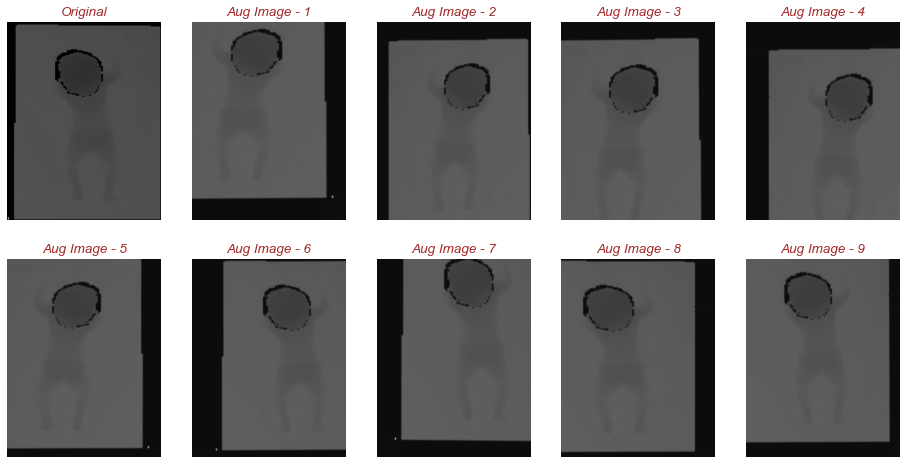

In [ ]:
# Lets see the augmented images
plot_aug_images(org_images=all_train_images, aug_images=augmented_images1)

In [ ]:
# Generating the augmented images of only 1 image
augmented_images2, augmented_labels2 = generate_aug_images(all_train_images[2:3], 
                                                         labels=train_labels, 
                                                         data_gen=train_img_gen, 
                                                         aug_img_dir=aug_imgs_path)

In [ ]:
# Checking the shapes of augmented images & labels array
augmented_images2.shape, augmented_labels2.shape

((9, 448, 448, 3), (9,))

In [ ]:
# Checking the image of 0th index augmented image
augmented_images2[0][0].shape

(448, 3)

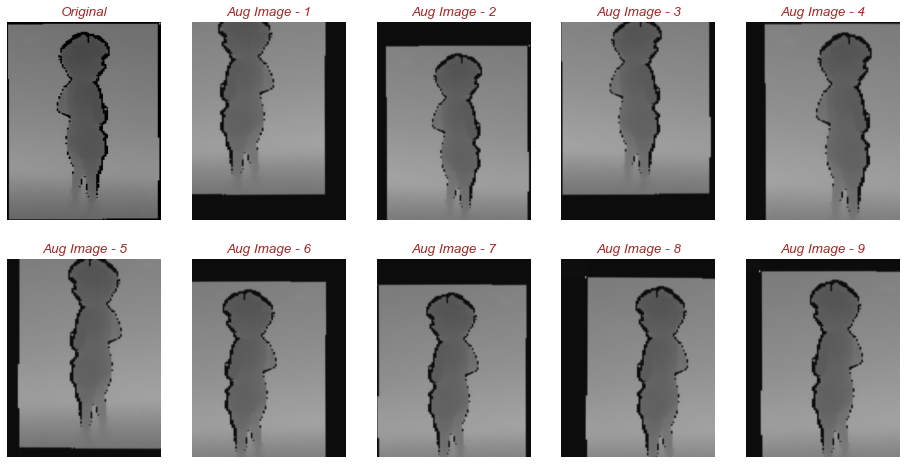

In [ ]:
# Lets see the augmented images
plot_aug_images(org_images=all_train_images[2:3], aug_images=augmented_images2)

In [ ]:
# Generating the augmented images of only 1 image
augmented_images3, augmented_labels3 = generate_aug_images(all_train_images[6:7], 
                                                         labels=train_labels, 
                                                         data_gen=train_img_gen, 
                                                         aug_img_dir=aug_imgs_path)

In [ ]:
# Checking the shapes of augmented images & labels array
augmented_images3.shape, augmented_labels3.shape

((9, 448, 448, 3), (9,))

In [ ]:
# Checking the image of 0th index augmented image
augmented_images3[0][0].shape

(448, 3)

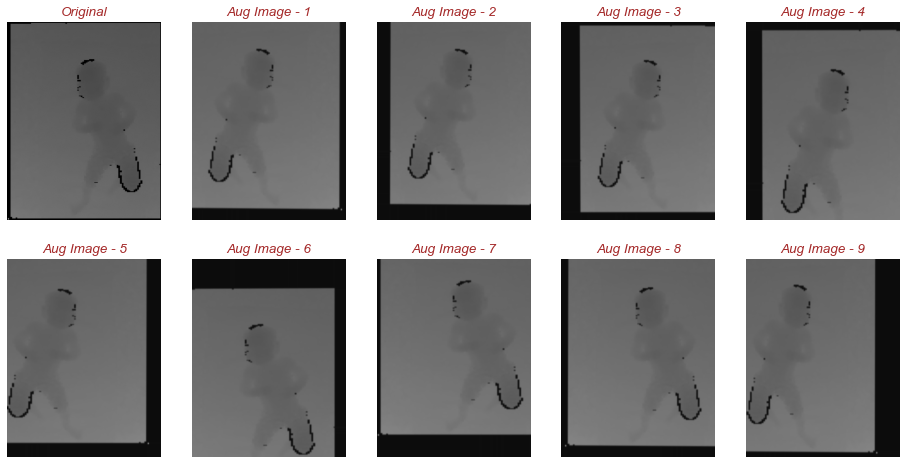

In [ ]:
# Lets see the augmented images
plot_aug_images(org_images=all_train_images[6:7], aug_images=augmented_images3)

In [25]:
# Generating the augmented images of all train images
augmented_images, augmented_labels = generate_aug_images(all_train_images, 
                                                         labels=train_labels, 
                                                         data_gen=train_img_gen, 
                                                         aug_img_dir=aug_imgs_path)

In [26]:
# Checking the shapes of augmented images & labels array
augmented_images.shape, augmented_labels.shape

((63, 448, 448, 3), (63,))

In [27]:
# Checking the image of 0th index augmented image
augmented_images[0][0].shape

(448, 3)

In [28]:
# Train and Validation Split
X_train, X_val, y_train, y_val = train_test_split(augmented_images, augmented_labels, test_size = 0.15, random_state = 44)

In [29]:
# Shape of TRAIN & VALIDATION sets after augmentation
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((53, 448, 448, 3), (10, 448, 448, 3), (53,), (10,))

In [30]:
# Checking the shape of the train tgt values object
y_train.shape

(53,)

In [31]:
# Checking the train tgt values object
y_train

array([ 76.7,  63.2,  63.2,  63.2,  63.2,  59.1,  63.2, 106.1,  99.9,
        66.4,  66.4,  99.9,  76.7, 106.1,  63.2,  99.9,  86.4,  66.4,
        66.4, 106.1,  99.9, 106.1,  59.1,  86.4,  99.9,  63.2,  76.7,
        86.4,  86.4,  99.9, 106.1, 106.1,  63.2,  59.1, 106.1, 106.1,
        76.7,  76.7,  59.1,  76.7,  86.4,  86.4,  86.4, 106.1,  66.4,
        76.7,  76.7,  99.9,  59.1,  66.4,  66.4,  99.9,  86.4],
      dtype=float32)

In [32]:
# Checking the shape of the validation tgt values object
y_val.shape

(10,)

In [33]:
# Checking the validation values object
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [34]:
# Checking type of all the above objects
type(X_train), type(y_train), type(X_val), type(y_val)

(numpy.ndarray, numpy.ndarray, numpy.ndarray, numpy.ndarray)

In [35]:
# Saving the pre-processed TRAIN, VALIDATION & TEST sets
np.savez("X_train.npz",X_train)
np.savez("y_train.npz",y_train)
np.savez("X_val.npz",X_val)
np.savez("y_val.npz",y_val)
np.savez("X_test.npz",X_test)
np.savez("y_test.npz",y_test)

In [36]:
# mount the drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [37]:
# copy it there
!cp X_train.npz /content/drive/MyDrive/CGM_Assignment
!cp y_train.npz /content/drive/MyDrive/CGM_Assignment
!cp X_val.npz /content/drive/MyDrive/CGM_Assignment
!cp y_val.npz /content/drive/MyDrive/CGM_Assignment
!cp X_test.npz /content/drive/MyDrive/CGM_Assignment
!cp y_test.npz /content/drive/MyDrive/CGM_Assignment

In [ ]:
# Downloading the X_train, y_train, X_val, y_val, X_test, y_test files
!gdown 1524vFizdo4a0SuXIZJQITtxbQbW9Brgi
!gdown 1DzBoXkHsPTmQujHpZ4wTHY9BSb6jDsyv
!gdown 1NgXIJ_7yAsVMv2tqrpTKX3y6CinoarvY
!gdown 1O5le8A_ZQ1orlNqP2uE5dLfsXR8Wjkbq
!gdown 1Uu2EELSljqobSS1tH1xDNiJg22MRuiTq
!gdown 1woSkEH-jlC7Vbl4ZTHY_6F14PdCiJMUC

In [ ]:
# Loading the X_train, y_train, X_val, y_val, X_test & y_test files in memory
x_train_file = np.load("X_train.npz")
X_train = x_train_file.f.arr_0

y_train_file = np.load("y_train.npz")
y_train = y_train_file.f.arr_0

x_val_file = np.load("X_val.npz")
X_val = x_val_file.f.arr_0

y_val_file = np.load("y_val.npz")
y_val = y_val_file.f.arr_0

x_test_file = np.load("X_test.npz")
X_test = x_test_file.f.arr_0

y_test_file = np.load("y_test.npz")
y_test = y_test_file.f.arr_0

In [38]:
# Checking types of TRAIN, VAL & TEST sets
type(X_train), type(y_train), type(X_val), type(y_val), type(X_test), type(y_test)

(numpy.ndarray,
 numpy.ndarray,
 numpy.ndarray,
 numpy.ndarray,
 numpy.ndarray,
 numpy.ndarray)

In [39]:
# Checking shapes of TRAIN, VAL & TEST sets
X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape

((53, 448, 448, 3), (53,), (10, 448, 448, 3), (10,), (2, 448, 448, 3), (2,))

**`OBSERVATION`**
- So, using the augmentation techniques we have got the much increased dataset with some variability in the images and better in representing the real-time like scenario.

## **`Defining_Performance_Metrics`**

In [39]:
from keras import backend as K

def r_square(y_true, y_pred):
    """
    Description : This function is created for calculating the value of the r-square.
    """
    # Calculating the residual
    diff = (y_true - y_pred)

    # Calculating the sum of squares of the residuals
    sum_of_squares_res = K.sum(K.square(diff)) 

    # Calculating the sum of squares of the total
    mean_y_true = K.mean(y_true)
    sum_of_squares_tot = K.sum(K.square(y_true - mean_y_true))

    # Calculating the R-Square
    r2_value = 1 - (sum_of_squares_res / (sum_of_squares_tot + K.epsilon()))
    return r2_value

In [40]:
# Loading the tensorboard
%load_ext tensorboard

# Folder storing all the runs logs
root_logdir = os.path.join(os.path.join(os.curdir, "logs"), "fit")

# Get current run logs directory
def get_run_logdir():
    run_id = time.strftime("run_%Y_%m_%d-%H_%M_%S")
    return os.path.join(root_logdir, run_id)

## **`Models_Training_Configuration`**

In [41]:
# Defining the batch-size
BATCH_SIZE = 9

# Using the AUTOTUNE algo for better allocation of computing resources for Dataset pipeline
AUTO = tf.data.experimental.AUTOTUNE

## **`Models`**

## **`A.Fine_Tuning---Last_3_Layers__+__Custom_TopLayers---ImageNet_Weights`**

### **`A1.ResNet---50`**

In [ ]:
# build the ResNet-50 network
resnet50_with_no_top_model = tf.keras.applications.ResNet50(include_top=False, weights='imagenet', input_shape=(448,448,3))

94765736/94765736 [==============================] - 0s 0us/step


In [ ]:
# Model summary
resnet50_with_no_top_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 448, 448, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 454, 454, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 224, 224, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [ ]:
# Instantiating Optimizer
learning_rate= 0.0001
opt1 = tf.keras.optimizers.Adam(learning_rate=learning_rate)

# Reduce Learning Rate on Plateau
reduce_lr1 = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=2, verbose=1, mode='auto', min_delta=0.0001)

In [ ]:
# Logs directory
curr_run_logdir1 = get_run_logdir()

# Instantiating Tensorboard callback
tensorboard_callback1 = TensorBoard(log_dir=curr_run_logdir1, histogram_freq=1)

In [ ]:
# Setting the seed
os.environ['PYTHONHASHSEED'] = '0'

# Clearing the TF session
tf.keras.backend.clear_session()

# defining the custom top of the ResNet-50 model
for layer in resnet50_with_no_top_model.layers[0:-3]:
    layer.trainable = False

# Adding additional layers
input_layer = resnet50_with_no_top_model.output
    
# Defining the top layers structure of the model
flatten = tf.keras.layers.GlobalAveragePooling2D(name='Flatten_for_hidden_layers')(input_layer)

dropout_1 = Dropout(rate=0.5, name='Dropout1')(flatten)

dense_layer1 = tf.keras.layers.Dense(units=128, 
                                     activation='relu', 
                                     use_bias=True, 
                                     kernel_initializer=tf.keras.initializers.he_normal(seed=80),
                                     bias_initializer=tf.keras.initializers.he_normal(seed=110),
                                     name='Hidden_Layer1')(dropout_1)

dropout_2 = Dropout(rate=0.5, name='Dropout2')(dense_layer1)

dense_layer2 = tf.keras.layers.Dense(units=128, 
                                     activation='relu', 
                                     use_bias=True, 
                                     kernel_initializer=tf.keras.initializers.he_normal(seed=80),
                                     bias_initializer=tf.keras.initializers.he_normal(seed=110),
                                     name='Hidden_Layer2')(dropout_2)

output_layer = tf.keras.layers.Dense(1, activation='linear', name="output")(dense_layer2)

# Instantiating the complete model
resnet_50 = Model(inputs=resnet50_with_no_top_model.input, outputs=output_layer)

# Compiling the model
resnet_50.compile(optimizer=opt1,
                  loss = 'mean_squared_error',
                  metrics=[r_square])

# Summary of the ResNet-50 model with custom top
resnet_50.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 448, 448, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 454, 454, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 224, 224, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

**`OBSERVATION`**
- So, the trainable params are 0.28 MM. In the other model, i'll to reduce them more becuase our dataset is very small.

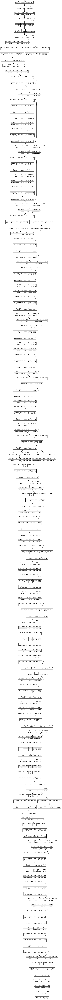

In [ ]:
# plotting the model
plot_model(resnet_50, to_file='resnet_50.png', show_shapes=True, show_layer_names=True)

In [ ]:
tf.autograph.experimental.do_not_convert(func=None)

<function tensorflow.python.autograph.impl.api.do_not_convert(func=None)>

In [ ]:
# Size of TRAIN & VALIDATION labels and BATCH SIZE
y_train.shape[0], BATCH_SIZE, y_val.shape[0]

(53, 9, 10)

In [ ]:
# Calculating train steps
train_steps = y_train.shape[0] // BATCH_SIZE
train_steps

5

In [ ]:
# Calculating test steps
valid_steps = y_val.shape[0] // BATCH_SIZE
valid_steps

1

In [ ]:
# Training the ResNet-50 model having custom top
history1 = resnet_50.fit(X_train, y_train,
                         epochs=15,
                         batch_size=BATCH_SIZE,
                         callbacks=[tensorboard_callback1, reduce_lr1],
                         steps_per_epoch=train_steps,
                         validation_steps=valid_steps,
                         validation_data=[X_val, y_val],
                         verbose=1)

Epoch 1/15
5/5 [==============================] - 49s 10s/step - loss: 7003.0762 - r_square: -29.9524 - val_loss: 4957.2769 - val_r_square: -25.1141 - lr: 1.0000e-04
Epoch 2/15
5/5 [==============================] - 38s 8s/step - loss: 6705.4595 - r_square: -21.9450 - val_loss: 4784.9590 - val_r_square: -24.2064 - lr: 1.0000e-04
Epoch 3/15
5/5 [==============================] - 48s 10s/step - loss: 6727.6392 - r_square: -26.8386 - val_loss: 4632.7388 - val_r_square: -23.4045 - lr: 1.0000e-04
Epoch 4/15
5/5 [==============================] - 47s 9s/step - loss: 6555.0513 - r_square: -27.5158 - val_loss: 4475.1504 - val_r_square: -22.5743 - lr: 1.0000e-04
Epoch 5/15
5/5 [==============================] - 39s 8s/step - loss: 6015.2046 - r_square: -27.5723 - val_loss: 4303.6104 - val_r_square: -21.6707 - lr: 1.0000e-04
Epoch 6/15
5/5 [==============================] - 44s 10s/step - loss: 6083.2095 - r_square: -24.5995 - val_loss: 4120.6885 - val_r_square: -20.7071 - lr: 1.0000e-04
Epoch 7

### **`Plot the Loss and R2 Graphs`**

### **`LOSS_Curves-1`**

In [ ]:
# Storing the TRAIN & VAL Losses
train_losses = history1.history['loss']
validation_losses = history1.history['val_loss']

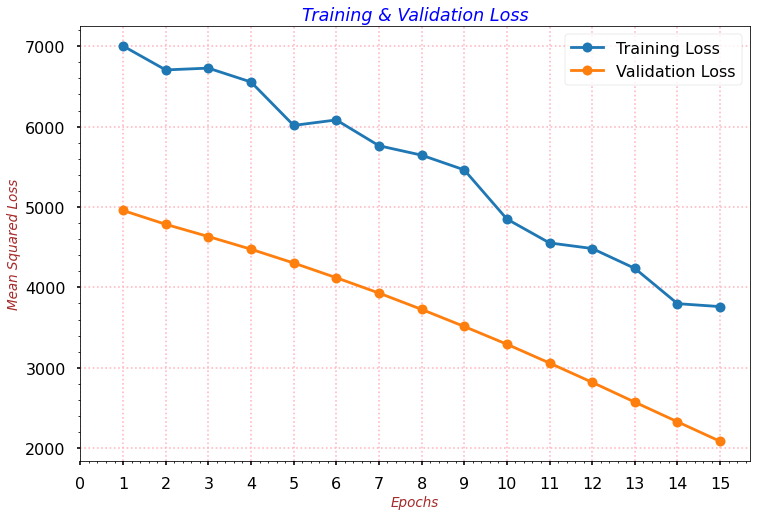

In [ ]:
# Generate a sequence of integers to represent the epoch numbers
epochs = range(1, 16)

with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(12,8))
    # Plot and label the training and validation loss values
    plt.plot(epochs, train_losses, label='Training Loss', marker='o', markersize=10)
    plt.plot(epochs, validation_losses, label='Validation Loss', marker='o', markersize=10)

    # Add in a title, grid and axes labels
    plt.title('Training & Validation Loss', fontdict=title_font_dict)
    plt.xlabel('Epochs', fontdict=label_font_dict)
    plt.ylabel('Mean Squared Loss', fontdict=label_font_dict)
    plt.grid(which='major', linestyle=":", color='lightpink')
    plt.minorticks_on()

    # Set the tick locations
    plt.xticks(arange(0, 16, 1))

    # Display the plot
    plt.legend(loc='best')
    plt.show()

**`OBSERVATION`**
- The above plots are telling us that we can run the process of training for more number of epochs as both the losses are still following the downward trend.
    - And, the difference b/w TRAIN & VAL losses is still visible. So, we can run it to a point where they converge.

### **`R_Square_Curves-1`**

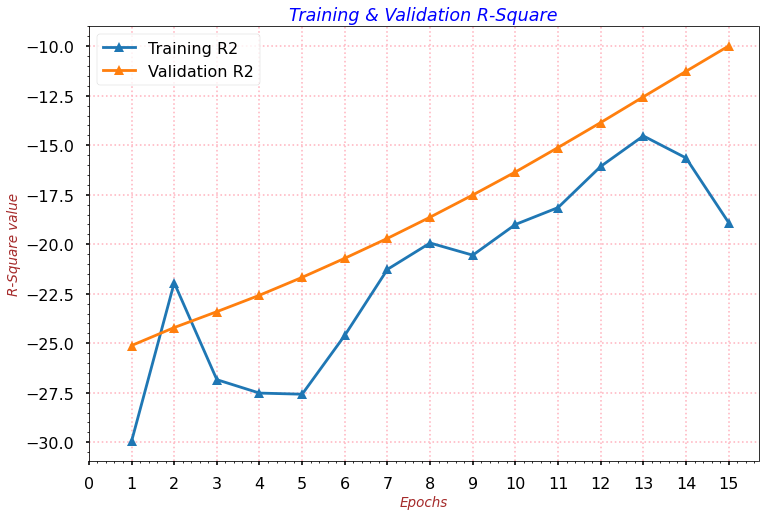

In [ ]:
# Storing the TRAIN & VAL R-square values
train_r2 = history1.history['r_square']
val_r2 = history1.history['val_r_square']

# Generate a sequence of integers to represent the epoch numbers
epochs = range(1, 16)

with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(12,8))
    # Plot and label the training and validation r-square values
    plt.plot(epochs, train_r2, label='Training R2', marker='^', markersize=10)
    plt.plot(epochs, val_r2, label='Validation R2', marker='^', markersize=10)
    plt.grid(which='major', linestyle=":", color='lightpink')
    plt.minorticks_on()

    # Add in a title and axes labels
    plt.title('Training & Validation R-Square', fontdict=title_font_dict)
    plt.xlabel('Epochs', fontdict=label_font_dict)
    plt.ylabel('R-Square value', fontdict=label_font_dict)

    # Set the tick locations
    plt.xticks(arange(0, 16, 1))

    # Display the plot
    plt.legend(loc='best')
    plt.show()

**`OBSERVATION`**
- The above plots are telling us that we can run the process of training for more number of epochs as both the scores are still following the upward trend.
    - Training loss & metric curves are fluctutating but Validation curves shows no sign of it.

### **Evaluating the Model**

#### **`VAL_Evaluation-1`**

In [ ]:
# Generating the model predictions on the validation set
val_heights = resnet_50.predict(X_val)
val_preds = []
for val in val_heights:
    val_preds.append((val[0]))

val_preds = np.array(val_preds)
val_preds

1/1 [==============================] - 8s 8s/step


array([26.534063, 26.688957, 26.343487, 26.851963, 26.60034 , 26.936205,
       26.607258, 26.310953, 26.984158, 26.613827], dtype=float32)

In [ ]:
# Actual VAL Tgt values
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [ ]:
# Validation R2 Score
r2_score(y_val, val_preds)

-10.469640721864407

**`OBSERVATION`**
- So, the score is not good. Hence, we can say that model is not working well.

#### **`TEST_Evaluation-1`**

In [ ]:
# Generating the model predictions on the TEST set
test_heights = resnet_50.predict(X_test)
test_preds = []
for val in test_heights:
    test_preds.append((val[0]))

test_preds = np.array(test_preds)
test_preds

1/1 [==============================] - 1s 1s/step


array([26.642708, 26.367102], dtype=float32)

In [ ]:
# Actual TEST Tgt values
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [ ]:
# TEST R2 Score
r2_score(y_test, test_preds)

-99.50112793638546

**`OBSERVATION`**
- So, the score is not good. Hence, we can say that model is not working well on the unseen images.

#### **Running TensorBoard - A1**

In [ ]:
# Fetching the directory name
curr_run_logdir1.split("/")[-1]

'run_2022_12_04-06_53_08'

In [ ]:
# Any running instances
notebook.list()

No known TensorBoard instances running.


In [ ]:
# Run TF Board
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

![model_1](E:\STUDY\PROJECTS\Assignment_CGM\1_ResNet50_Hists.png)

**`OBSERVATIONS`**

- If we observe the histograms of the Dense/Hidden layers then they are normally distributed but majority of the values are very close to 0.

## **`B.Fine_Tuning---Custom_TopLayers---ImageNet_Weights`**

In [40]:
# Loading the required libraries
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.ensemble import RandomForestRegressor

### **`B1.ResNet---50`**

In [60]:
# build the ResNet-50 network
resnet50_with_no_top_model = tf.keras.applications.ResNet50(include_top=False, weights='imagenet', input_shape=(448,448,3))

In [61]:
# Model summary
resnet50_with_no_top_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 448, 448, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 454, 454, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 224, 224, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [62]:
from tensorflow.keras.callbacks import ModelCheckpoint

In [63]:
# Instantiating Optimizer
learning_rate= 0.0001
opt2 = tf.keras.optimizers.Adam(learning_rate=learning_rate)

# Reduce Learning Rate on Plateau
reduce_lr2 = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=2, verbose=1, mode='auto', min_delta=0.0001)

# Checkpointing
filepath = "weights-{epoch:02d}-{val_loss:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='auto')

In [64]:
# Logs directory
curr_run_logdir2 = get_run_logdir()

# Instantiating Tensorboard callback
tensorboard_callback2 = TensorBoard(log_dir=curr_run_logdir2, histogram_freq=1)

In [65]:
# Setting the seed
os.environ['PYTHONHASHSEED'] = '0'

# Clearing the TF session
tf.keras.backend.clear_session()

# defining the custom top of the ResNet-50 model
for layer in resnet50_with_no_top_model.layers:
    layer.trainable = False

# Adding additional layers
input_layer = resnet50_with_no_top_model.output
    
# Defining the top layers structure of the model
flatten = tf.keras.layers.GlobalAveragePooling2D(name='Flatten_for_hidden_layers')(input_layer)

dropout_1 = Dropout(rate=0.5, name='Dropout1')(flatten)

dense_layer1 = tf.keras.layers.Dense(units=64, 
                                     activation='relu', 
                                     use_bias=True, 
                                     kernel_initializer=tf.keras.initializers.he_normal(seed=80),
                                     bias_initializer=tf.keras.initializers.he_normal(seed=110),
                                     name='Hidden_Layer1')(dropout_1)

dropout_2 = Dropout(rate=0.5, name='Dropout2')(dense_layer1)

dense_layer2 = tf.keras.layers.Dense(units=128, 
                                     activation='relu', 
                                     use_bias=True, 
                                     kernel_initializer=tf.keras.initializers.he_normal(seed=80),
                                     bias_initializer=tf.keras.initializers.he_normal(seed=110),
                                     name='Hidden_Layer2')(dropout_2)

output_layer = tf.keras.layers.Dense(1, activation='linear', name="output")(dense_layer2)

# Instantiating the complete model
resnet_50b = Model(inputs=resnet50_with_no_top_model.input, outputs=output_layer)

# Compiling the model
resnet_50b.compile(optimizer=opt2,
                  loss = 'mean_squared_error',
                  metrics=[r_square])

# Summary of the ResNet-50 model with custom top
resnet_50b.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 448, 448, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 454, 454, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 224, 224, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

**`OBSERVATION`**
- The trainable params are 0.139 MM and it is significantly lesser than the previous model.

In [66]:
# serialize model to JSON
model_json = resnet_50b.to_json()

In [70]:
# Saving the resnet 50 architecture as a JSON file
import json
with open('resnet_50b.json', 'w') as json_file:
    json_file.write(model_json)

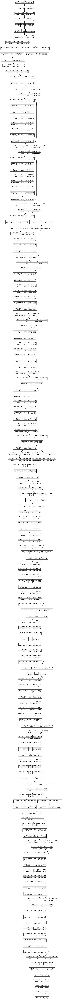

In [50]:
# plotting the model
plot_model(resnet_50b, to_file='resnet_50b.png', show_shapes=True, show_layer_names=True)

In [51]:
tf.autograph.experimental.do_not_convert(func=None)

<function tensorflow.python.autograph.impl.api.do_not_convert(func=None)>

In [52]:
# Size of TRAIN & VALIDATION labels and BATCH SIZE
y_train.shape[0], BATCH_SIZE, y_val.shape[0]

(53, 9, 10)

In [53]:
# Calculating train steps
train_steps = y_train.shape[0] // BATCH_SIZE
train_steps

5

In [54]:
# Calculating test steps
valid_steps = y_val.shape[0] // BATCH_SIZE
valid_steps

1

In [55]:
# Training the ResNet-50 model having custom top
history2 = resnet_50b.fit(X_train, y_train,
                         epochs=30,
                         batch_size=BATCH_SIZE,
                         callbacks=[tensorboard_callback2, reduce_lr2, checkpoint],
                         steps_per_epoch=train_steps,
                         validation_steps=valid_steps,
                         validation_data=[X_val, y_val],
                         verbose=1)

Epoch 1/30
5/5 [==============================] - ETA: 0s - loss: 6198.6245 - r_square: -22.7924
Epoch 1: val_loss improved from inf to 4428.71338, saving model to weights-01-4428.71.hdf5
5/5 [==============================] - 18s 2s/step - loss: 6198.6245 - r_square: -22.7924 - val_loss: 4428.7134 - val_r_square: -22.3297 - lr: 1.0000e-04
Epoch 2/30
5/5 [==============================] - ETA: 0s - loss: 6084.4565 - r_square: -22.1090
Epoch 2: val_loss improved from 4428.71338 to 4308.65234, saving model to weights-02-4308.65.hdf5
5/5 [==============================] - 7s 1s/step - loss: 6084.4565 - r_square: -22.1090 - val_loss: 4308.6523 - val_r_square: -21.6973 - lr: 1.0000e-04
Epoch 3/30
5/5 [==============================] - ETA: 0s - loss: 6203.9785 - r_square: -21.3119
Epoch 3: val_loss improved from 4308.65234 to 4185.42871, saving model to weights-03-4185.43.hdf5
5/5 [==============================] - 6s 1s/step - loss: 6203.9785 - r_square: -21.3119 - val_loss: 4185.4287 - va

In [72]:
# copy it there
## Copying the final model weights and the model arch JSON files
!cp weights-30-193.21.hdf5 /content/drive/MyDrive/CGM_Assignment
!cp resnet_50b.json /content/drive/MyDrive/CGM_Assignment

### **`LOSS_Curves-2`**

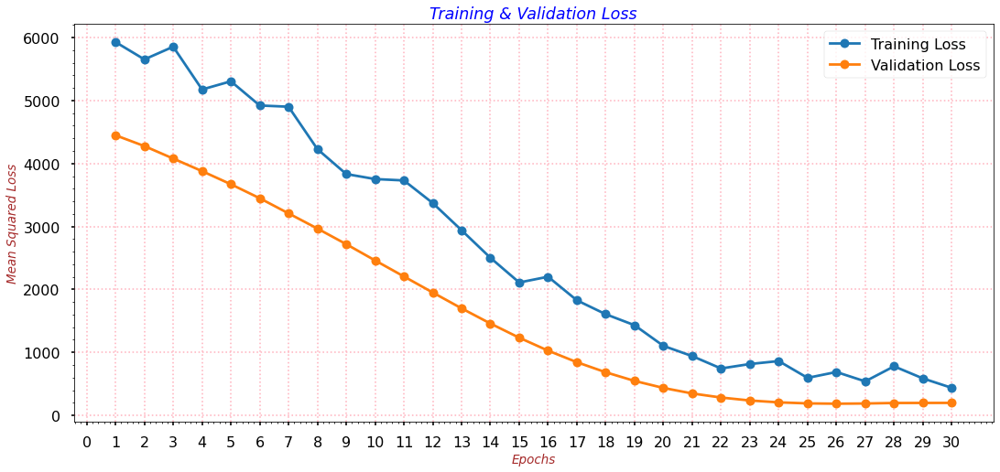

In [ ]:
# Storing the TRAIN & VAL Losses
train_losses = history2.history['loss']
validation_losses = history2.history['val_loss']

# Generate a sequence of integers to represent the epoch numbers
epochs = range(1, 31)

with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(18,8))
    # Plot and label the training and validation loss values
    plt.plot(epochs, train_losses, label='Training Loss', marker='o', markersize=10)
    plt.plot(epochs, validation_losses, label='Validation Loss', marker='o', markersize=10)

    # Add in a title, grid and axes labels
    plt.title('Training & Validation Loss', fontdict=title_font_dict)
    plt.xlabel('Epochs', fontdict=label_font_dict)
    plt.ylabel('Mean Squared Loss', fontdict=label_font_dict)
    plt.grid(which='major', linestyle=":", color='lightpink')
    plt.minorticks_on()

    # Set the tick locations
    plt.xticks(arange(0, 31, 1))

    # Display the plot
    plt.legend(loc='best')
    plt.show()

**`OBSERVATION`**
- The above plots are telling us that we can run the process of training for more number of epochs as both the losses are still following the downward trend.
    - As, the number of epochs are increasing the difference b/w the TRAIN & VAL loss is reducing.
    - VAL curve is pretty much smooth but TRAINING curve has some fluctuations. This might be because we have very small records in val set.

### **`R_Square_Curves-2`**

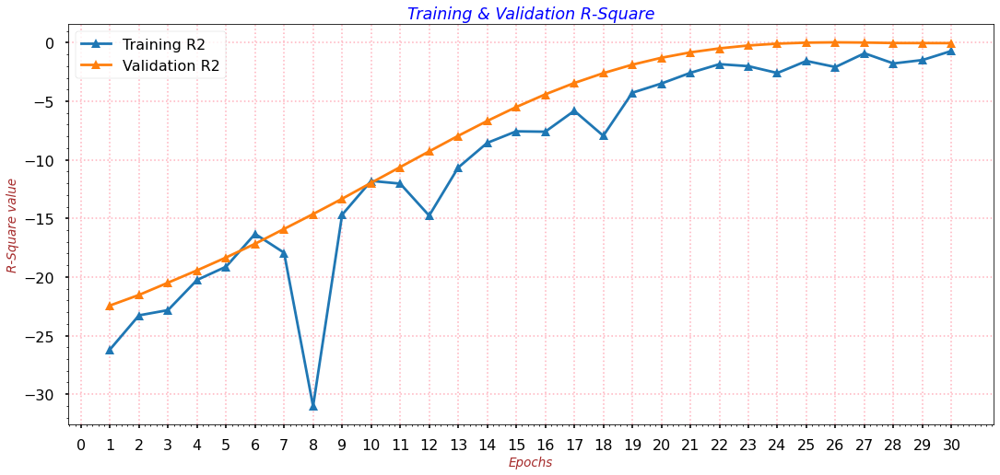

In [ ]:
# Storing the TRAIN & VAL R-square values
train_r2 = history2.history['r_square']
val_r2 = history2.history['val_r_square']

# Generate a sequence of integers to represent the epoch numbers
epochs = range(1, 31)

with plt.style.context('seaborn-poster'):
    plt.figure(figsize=(18,8))
    # Plot and label the training and validation r-square values
    plt.plot(epochs, train_r2, label='Training R2', marker='^', markersize=10)
    plt.plot(epochs, val_r2, label='Validation R2', marker='^', markersize=10)
    plt.grid(which='major', linestyle=":", color='lightpink')
    plt.minorticks_on()

    # Add in a title, grid and axes labels
    plt.title('Training & Validation R-Square', fontdict=title_font_dict)
    plt.xlabel('Epochs', fontdict=label_font_dict)
    plt.ylabel('R-Square value', fontdict=label_font_dict)

    # Set the tick locations
    plt.xticks(arange(0, 31, 1))

    # Display the plot
    plt.legend(loc='best')
    plt.show()

**`OBSERVATION`**
- The above plots are telling us that we can run the process of training for more number of epochs as both the scores are still following the upward trend.
    - As, the number of epochs are increasing the difference b/w the TRAIN & VAL R-square is reducing.
    - VAL curve is pretty much smooth but TRAINING curve has some fluctuations. This might be because we have very small records in val set.

### **Evaluating the Model**

#### **`VAL_Evaluation-2`**

In [ ]:
# Generating the model predictions on the validation set
val_heights = resnet_50b.predict(X_val)
val_preds = []
for val in val_heights:
    val_preds.append((val[0]))

val_preds = np.array(val_preds)
val_preds

1/1 [==============================] - 2s 2s/step


array([74.21175 , 73.58505 , 73.8923  , 73.57336 , 73.87943 , 74.99591 ,
       73.747246, 73.07043 , 74.002716, 73.92571 ], dtype=float32)

In [ ]:
# Actual VAL Tgt values
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [ ]:
# Validation R2 Score
r2_score(y_val, val_preds)

-0.07958032444093321

**`OBSERVATION`**
- So, the score is not good. Hence, we can say that model is not working well.

#### **`TEST_Evaluation-2`**

In [ ]:
# Generating the model predictions on the TEST set
test_heights = resnet_50b.predict(X_test)
test_preds = []
for val in test_heights:
    test_preds.append((val[0]))

test_preds = np.array(test_preds)
test_preds

1/1 [==============================] - 1s 874ms/step


array([73.012566, 73.15798 ], dtype=float32)

In [ ]:
# Actual TEST Tgt values
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [ ]:
# TEST R2 Score
r2_score(y_test, test_preds)

-9.485007287379972

**`OBSERVATION`**
- So, the score is not good. Hence, we can say that model is not working well on the unseen images.

#### **Running TensorBoard - B1**

In [ ]:
# Fetching the directory name
curr_run_logdir2.split("/")[-1]

'run_2022_12_04-07_15_32'

In [ ]:
# Any running instances
notebook.list()

Known TensorBoard instances:
  - port 6006: logdir logs (started 0:34:24 ago; pid 734)


In [ ]:
# Running the TF Board
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 734), started 0:34:27 ago. (Use '!kill 734' to kill it.)

<IPython.core.display.Javascript object>

![model_2](E:\STUDY\PROJECTS\Assignment_CGM\2_ResNet50_Hists.png)

**`OBSERVATIONS`**

- If we observe the histograms of the Dense/Hidden layers then they are normally distributed but majority of the values are very close to 0.

### **`Predictions_and_Scores_on_VAL_Set`**

In [ ]:
# Generating the prediction on X_VAL
y_pred = resnet_50b.predict(X_val)

1/1 [==============================] - 0s 38ms/step


In [ ]:
# Predictions on VAL set
val_preds = []
for val in y_pred:
    val_preds.append((val[0]))

val_preds = np.array(val_preds)
val_preds

array([74.21175 , 73.58505 , 73.8923  , 73.57336 , 73.87943 , 74.99591 ,
       73.747246, 73.07043 , 74.002716, 73.92571 ], dtype=float32)

In [ ]:
# Actual VAL set tgt values
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [ ]:
# MSE on VAL Set
print("MSE on VAL set is --> {}".format(np.round(mean_squared_error(y_val, val_preds),3)))

MSE on VAL set is --> 189.26600646972656


In [ ]:
# MAE on VAL Set
print("MAE on VAL set is --> {}".format(np.round(mean_absolute_error(y_val, val_preds),3)))

MAE on VAL set is --> 12.434000015258789


In [ ]:
# MAPE on VAL Set
print("MAPE on VAL set is --> {}".format(np.round(mean_absolute_percentage_error(y_val, val_preds),3)))

MAPE on VAL set is --> 0.1809999942779541


In [ ]:
# R2 Score on VAL Set
print("MAPE on VAL set is --> {}".format(np.round(r2_score(y_val, val_preds),3)))

MAPE on VAL set is --> -0.08


In [ ]:
# Calculating the Error metrics
val_error =  np.abs(y_val - val_preds)
mean_error = np.mean(val_error)
min_error = np.min(val_error)
max_error = np.max(val_error)
std_error = np.std(val_error)

In [ ]:
# Error metrics on VAL Set
print("####   Error Metrics on VAL Set   ####")
print("std_error: ",std_error)
print("mean_error: ",mean_error)
print("min_error: ",min_error)
print("max_error: ",max_error)

####   Error Metrics on VAL Set   ####
std_error:  5.887427
mean_error:  12.433993
min_error:  3.1266403
max_error:  25.897285


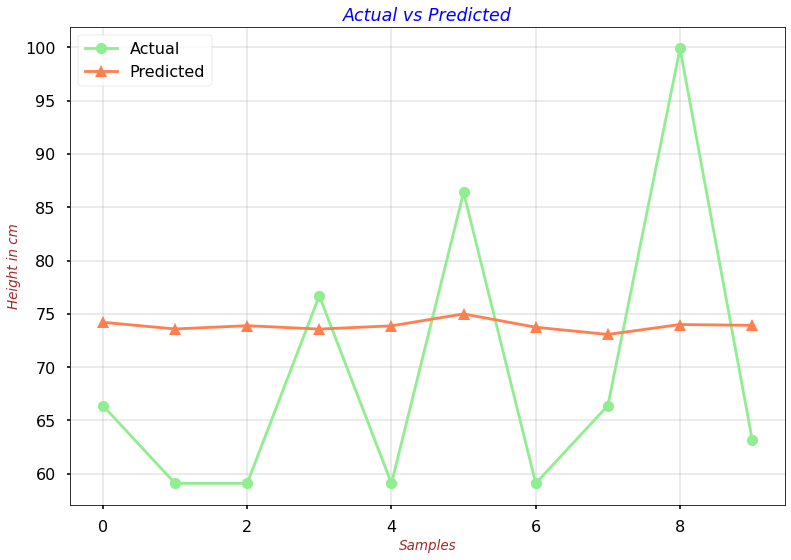

In [ ]:
# Plotting the predictions
with plt.style.context('seaborn-poster'):
    # Visualising the Acutal and predicted Result
    plt.plot(y_val, color = 'lightgreen', label = 'Actual', marker='o')
    plt.plot(val_preds, color = 'coral', label = 'Predicted', marker='^')
    plt.grid(alpha = 0.3)
    plt.xlabel('Samples', fontdict=label_font_dict)
    plt.ylabel('Height in cm', fontdict=label_font_dict)
    plt.title('Actual vs Predicted', fontdict=title_font_dict)
    plt.legend()
    plt.show()

**`OBSERVATION`**
- Here, it is clearly evident that the predictions of the model are not varying and appears to be around 75 only.

## **`C.DL_FEATURES---ML_Regressor_Model`**

In [41]:
# Loading the model arch JSON file and model weights
!gdown 1YJWChf3MmiiKs86fpXww6_1jnoY68Jlb
!gdown 1sTuiWCHjKQJIjAHigapEFCZ1bKXqzJZw

Downloading...
From: https://drive.google.com/uc?id=1YJWChf3MmiiKs86fpXww6_1jnoY68Jlb
To: /content/resnet_50b.json
100% 86.6k/86.6k [00:00<00:00, 87.7MB/s]
Downloading...
From: https://drive.google.com/uc?id=1sTuiWCHjKQJIjAHigapEFCZ1bKXqzJZw
To: /content/weights-30-193.21.hdf5
100% 96.6M/96.6M [00:02<00:00, 41.4MB/s]


In [42]:
from tensorflow.keras.models import model_from_json

In [43]:
# loading Models' JSON and creating the Model
with open('resnet_50b.json', 'r') as model_json_file:
    loaded_model_json = model_json_file.read()
    
# Loading the model from json
loaded_model = model_from_json(loaded_model_json)

# load weights into new model
loaded_model.load_weights("weights-30-193.21.hdf5")

In [44]:
# Storing the DL Model with top layers excluded
new_model = tf.keras.models.Model(loaded_model.input, 
                                  loaded_model.get_layer('Flatten_for_hidden_layers').output)

In [45]:
# Generating the features for X_TRAIN
features_x_train = new_model.predict(X_train)

2/2 [==============================] - 12s 2s/step


In [46]:
# Shape of X_TRAIN features
features_x_train.shape

(53, 2048)

In [47]:
# Generating the X_VAL features
features_x_val = new_model.predict(X_val)

1/1 [==============================] - 1s 1s/step


In [48]:
# Shape of X_VAL features
features_x_val.shape

(10, 2048)

In [49]:
# Instantiating the Standard Scaler and training it
scaler = StandardScaler()
scaler.fit(features_x_train)

StandardScaler()

In [50]:
# Standardizing the X_TRAIN & X_VAL features
x_tr = scaler.transform(features_x_train)
x_vl = scaler.transform(features_x_val)

In [51]:
# Fitting the RF Regressor model with no HPTuning
clf = RandomForestRegressor(max_depth = 4, n_estimators = 10)
clf.fit(x_tr, y_train)

RandomForestRegressor(max_depth=4, n_estimators=10)

### **`Predictions_and_Scores_on_VAL_Set`**

In [52]:
# Generating the prediction on X_VAL
y_pred = clf.predict(x_vl)

In [53]:
# Predictions on VAL set
y_pred

array([72.2599987 , 67.06999931, 64.46000023, 70.90999908, 64.05      ,
       97.6       , 70.58999901, 62.84000015, 99.90000153, 70.17999878])

In [54]:
# Actual VAL set tgt values
y_val

array([66.4, 59.1, 59.1, 76.7, 59.1, 86.4, 59.1, 66.4, 99.9, 63.2],
      dtype=float32)

In [55]:
# MSE on VAL Set
print("MSE on VAL set is --> {}".format(np.round(mean_squared_error(y_val, y_pred),3)))

MSE on VAL set is --> 50.347


In [56]:
# MAE on VAL Set
print("MAE on VAL set is --> {}".format(np.round(mean_absolute_error(y_val, y_pred),3)))

MAE on VAL set is --> 6.316


In [57]:
# MAPE on VAL Set
print("MAPE on VAL set is --> {}".format(np.round(mean_absolute_percentage_error(y_val, y_pred),3)))

MAPE on VAL set is --> 0.096


In [58]:
# R2 Score on VAL Set
print("MAPE on VAL set is --> {}".format(np.round(r2_score(y_val, y_pred),3)))

MAPE on VAL set is --> 0.713


In [59]:
# Calculating the Error metrics
val_error =  np.abs(y_val - y_pred)
mean_error = np.mean(val_error)
min_error = np.min(val_error)
max_error = np.max(val_error)
std_error = np.std(val_error)

In [60]:
# Error metrics on VAL Set
print("####   Error Metrics on VAL Set   ####")
print("std_error: ",std_error)
print("mean_error: ",mean_error)
print("min_error: ",min_error)
print("max_error: ",max_error)

####   Error Metrics on VAL Set   ####
std_error:  3.2334535792550008
mean_error:  6.315999755859375
min_error:  0.0
max_error:  11.490000534057614


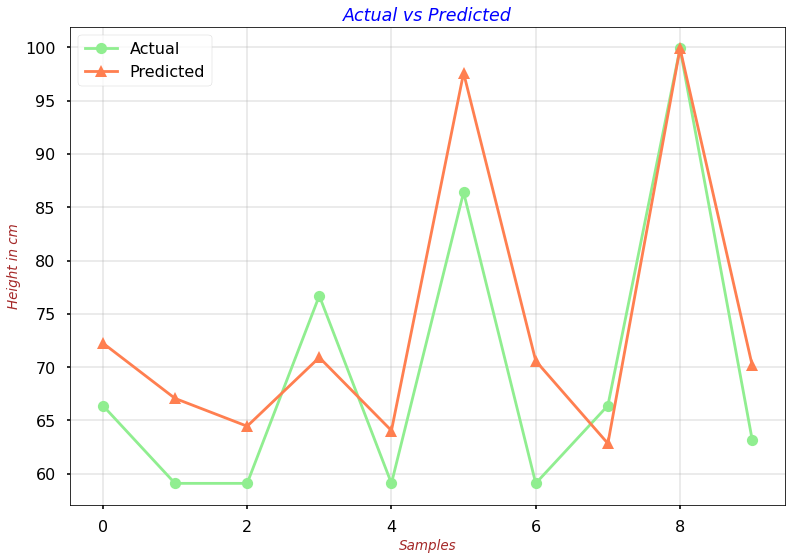

In [61]:
# Plotting the predictions
with plt.style.context('seaborn-poster'):
    # Visualising the Acutal and predicted Result
    plt.plot(y_val, color = 'lightgreen', label = 'Actual', marker='o')
    plt.plot(y_pred, color = 'coral', label = 'Predicted', marker='^')
    plt.grid(alpha = 0.3)
    plt.xlabel('Samples', fontdict=label_font_dict)
    plt.ylabel('Height in cm', fontdict=label_font_dict)
    plt.title('Actual vs Predicted', fontdict=title_font_dict)
    plt.legend()
    plt.show()

**`OBSERVATION`**
- This looks good as compare to all the previous results. Here, the predictions are varying and the difference is also less with the actuals.

In [63]:
# Save the model as a joblib
import joblib

In [64]:
# saving our model # model - model , filename-model_jlib
joblib.dump(clf , 'rf_model_jlib')

['rf_model_jlib']

In [65]:
# Copying the model into the Drive
!cp rf_model_jlib /content/drive/MyDrive/CGM_Assignment

In [66]:
# opening the file- model_jlib
loaded_rf = joblib.load('rf_model_jlib')

## **`D.TOP_and_BOTTOM_DistanceFeatures---ML_Regressor_Model`**

In [ ]:
from sklearn.svm import SVR

In [ ]:
# Seggregating the Features and TGT column
hp_dist_df = hp_df.drop(['Img_name'], axis=1)
X = hp_dist_df.drop(['Height'],axis=1)
y = hp_dist_df['Height']

In [ ]:
hp_dist_df

,nose_top_dist,nose_bottom_dist,left_eye_top_dist,left_eye_bottom_dist,right_eye_top_dist,right_eye_bottom_dist,left_ear_top_dist,left_ear_bottom_dist,right_ear_top_dist,right_ear_bottom_dist,left_shoulder_top_dist,left_shoulder_bottom_dist,right_shoulder_top_dist,right_shoulder_bottom_dist,left_elbow_top_dist,left_elbow_bottom_dist,right_elbow_top_dist,right_elbow_bottom_dist,left_wrist_top_dist,left_wrist_bottom_dist,right_wrist_top_dist,right_wrist_bottom_dist,left_hip_top_dist,left_hip_bottom_dist,right_hip_top_dist,right_hip_bottom_dist,left_knee_top_dist,left_knee_bottom_dist,right_knee_top_dist,right_knee_bottom_dist,left_ankle_top_dist,left_ankle_bottom_dist,right_ankle_top_dist,right_ankle_bottom_dist,Height
0,139.691,453.810,151.440,460.771,113.032,476.286,180.259,445.126,101.246,478.053,224.946,388.402,163.677,412.205,291.861,332.618,218.935,368.847,319.802,276.817,235.590,342.005,352.147,229.775,330.627,247.948,457.988,118.041,400.249,210.554,426.089,152.056,458.407,194.857,76.7
1,219.240,376.907,107.062,464.210,208.241,395.238,139.040,432.574,202.198,386.158,170.682,399.706,237.697,349.583,130.723,440.394,287.228,340.067,95.316,481.054,291.823,375.793,306.436,272.108,332.235,238.045,374.111,226.972,393.302,177.855,447.702,165.827,464.532,105.850,66.4
2,114.684,464.978,121.393,460.750,209.028,415.961,139.339,438.516,210.612,412.764,180.103,396.358,244.709,353.241,117.177,462.027,254.459,392.036,107.047,483.412,254.249,442.271,334.531,250.052,365.415,211.029,409.651,202.716,429.890,146.674,489.473,148.322,489.456,103.502,63.2
3,150.096,505.597,155.437,516.805,127.744,524.638,185.402,504.764,125.420,520.907,242.182,436.003,178.191,464.880,308.353,359.789,245.235,406.229,362.151,296.329,311.701,352.524,369.434,274.015,348.848,301.257,464.828,182.184,445.466,225.565,543.030,128.115,531.762,177.651,87.1
4,91.655,500.699,88.932,502.501,89.834,501.079,122.090,470.116,167.362,470.016,160.697,430.627,194.623,439.693,129.537,468.497,212.710,471.281,84.680,507.193,183.968,515.070,308.260,285.770,327.234,268.397,381.836,239.404,422.678,168.536,479.981,165.535,507.097,90.993,59.1
5,190.423,472.569,179.159,487.789,172.724,488.188,131.322,488.105,136.639,483.716,169.193,435.949,209.694,408.771,239.258,375.096,310.914,304.460,271.681,333.434,289.150,337.040,329.403,282.248,353.680,251.499,447.742,172.448,467.127,140.664,547.518,117.861,567.176,64.311,86.4
6,142.212,458.133,136.621,473.452,116.796,480.265,155.741,472.965,103.867,489.563,221.702,394.308,180.226,415.960,300.493,308.431,263.732,342.875,364.402,238.180,337.507,279.494,329.515,265.448,312.568,285.209,422.124,171.750,414.752,195.807,488.571,113.838,492.155,138.798,100.6
7,118.411,437.884,110.964,454.636,96.762,457.973,135.269,443.555,101.644,451.652,199.977,375.700,158.455,396.762,280.915,285.278,247.099,316.309,344.566,216.070,329.922,244.375,325.652,228.244,312.485,246.740,409.378,146.260,405.849,163.278,479.062,91.341,475.298,110.771,106.1
8,179.026,501.837,174.395,509.670,176.691,516.647,111.132,530.799,170.003,517.505,173.186,468.816,238.792,433.049,277.820,377.785,333.128,325.585,348.933,315.665,400.402,253.969,354.905,290.880,378.720,261.624,464.386,197.124,471.840,167.764,571.270,159.135,583.359,62.913,99.9


In [ ]:
# Train and Validation Split
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=2022)

In [ ]:
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((7, 34), (2, 34), (7,), (2,))

In [ ]:
# Instantiating the Standard Scaler and training it
scaler = StandardScaler()
scaler.fit(x_train)

StandardScaler()

In [ ]:
# Standardizing the X_TRAIN & X_VAL features
x_tr = scaler.transform(x_train)
x_vl = scaler.transform(x_test)

In [ ]:
# Instantiating the SVR model
svm_reg = SVR()

# Training the model
svm_reg_model = svm_reg.fit(x_tr, y_train)

### **`Predictions_and_Scores_on_TRAIN_Set`**

In [ ]:
# Generating the prediction on X_TRAIN
y_pred_tr = svm_reg_model.predict(x_tr)

In [ ]:
# Predictions on TRAIN set
y_pred_tr

array([75.36824013, 75.17395236, 77.72584253, 77.86053893, 77.39585779,
       75.12385601, 76.7       ])

In [ ]:
# Actual TRAIN set tgt values
y_train = y_train.values
y_train

array([ 59.1,  63.2,  86.4,  99.9, 106.1,  66.4,  76.7])

In [ ]:
# MSE on TRAIN Set
print("MSE on TRAIN set is --> {}".format(np.round(mean_squared_error(y_train, y_pred_tr),3)))

MSE on TRAIN set is --> 267.006


In [ ]:
# MAE on TRAIN Set
print("MAE on TRAIN set is --> {}".format(np.round(mean_absolute_error(y_train, y_pred_tr),3)))

MAE on TRAIN set is --> 13.769


In [ ]:
# MAPE on TRAIN Set
print("MAPE on VAL set is --> {}".format(np.round(mean_absolute_percentage_error(y_train, y_pred_tr),3)))

MAPE on VAL set is --> 0.17


In [ ]:
# R2 Score on TRAIN Set
print("R2 Score on TRAIN set is --> {}".format(np.round(r2_score(y_train, y_pred_tr),3)))

R2 Score on TRAIN set is --> 0.08


In [ ]:
# Calculating the Error metrics
train_error =  np.abs(y_train - y_pred_tr)
mean_error = np.mean(train_error)
min_error = np.min(train_error)
max_error = np.max(train_error)
std_error = np.std(train_error)

In [ ]:
# Error metrics on TRAIN Set
print("######   Error Metrics on TRAIN Set   ######\n")
print("-- std_error: {}\n".format(np.round(std_error,3)))
print("-- mean_error: {}\n".format(np.round(mean_error,3)))
print("-- min_error: {}\n".format(np.round(min_error,3)))
print("-- max_error: {}\n".format(np.round(max_error,3)))

######   Error Metrics on TRAIN Set   ######

-- std_error: 8.799

-- mean_error: 13.769

-- min_error: 0.0

-- max_error: 28.704



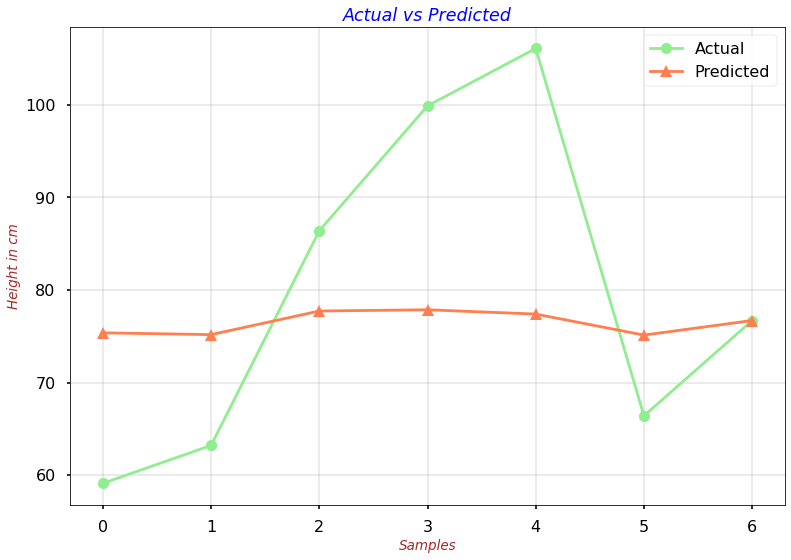

In [ ]:
# Plotting the predictions
with plt.style.context('seaborn-poster'):
    # Visualising the Acutal and predicted Result
    plt.plot(y_train, color = 'lightgreen', label = 'Actual', marker='o')
    plt.plot(y_pred_tr, color = 'coral', label = 'Predicted', marker='^')
    plt.grid(alpha = 0.3)
    plt.xlabel('Samples', fontdict=label_font_dict)
    plt.ylabel('Height in cm', fontdict=label_font_dict)
    plt.title('Actual vs Predicted', fontdict=title_font_dict)
    plt.legend()
    plt.show()

**`OBSERVATION`**
- Here, it is clearly evident that the predictions of the model are not varying and appears to be around 75 only.

### **`Predictions_and_Scores_on_VAL_Set`**

In [ ]:
# Generating the prediction on X_VAL
y_pred = svm_reg_model.predict(x_vl)

In [ ]:
# Predictions on VAL set
y_pred

array([77.10322727, 76.65127704])

In [ ]:
# Actual VAL set tgt values
y_test = y_test.values
y_test

array([100.6,  87.1])

In [ ]:
# MSE on VAL Set
print("MSE on VAL set is --> {}".format(np.round(mean_squared_error(y_test, y_pred),3)))

MSE on VAL set is --> 330.637


In [ ]:
# MAE on VAL Set
print("MAE on VAL set is --> {}".format(np.round(mean_absolute_error(y_test, y_pred),3)))

MAE on VAL set is --> 16.973


In [ ]:
# MAPE on VAL Set
print("MAPE on VAL set is --> {}".format(np.round(mean_absolute_percentage_error(y_test, y_pred),3)))

MAPE on VAL set is --> 0.177


In [ ]:
# R2 Score on VAL Set
print("MAPE on VAL set is --> {}".format(np.round(r2_score(y_test, y_pred),3)))

MAPE on VAL set is --> -6.257


In [ ]:
# Calculating the Error metrics
val_error =  np.abs(y_test - y_pred)
mean_error = np.mean(val_error)
min_error = np.min(val_error)
max_error = np.max(val_error)
std_error = np.std(val_error)

In [ ]:
# Error metrics on TRAIN Set
print("######   Error Metrics on TRAIN Set   ######\n")
print("-- std_error: {}\n".format(np.round(std_error,3)))
print("-- mean_error: {}\n".format(np.round(mean_error,3)))
print("-- min_error: {}\n".format(np.round(min_error,3)))
print("-- max_error: {}\n".format(np.round(max_error,3)))

######   Error Metrics on TRAIN Set   ######

-- std_error: 6.524

-- mean_error: 16.973

-- min_error: 10.449

-- max_error: 23.497



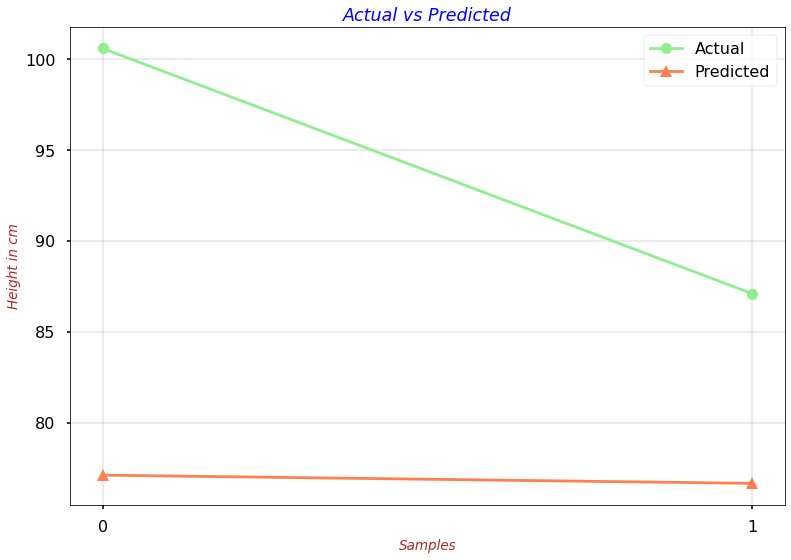

In [ ]:
# Plotting the predictions
with plt.style.context('seaborn-poster'):
    # Visualising the Acutal and predicted Result
    plt.plot(y_test, color = 'lightgreen', label = 'Actual', marker='o')
    plt.plot(y_pred, color = 'coral', label = 'Predicted', marker='^')
    plt.grid(alpha = 0.3)
    plt.xlabel('Samples', fontdict=label_font_dict)
    plt.ylabel('Height in cm', fontdict=label_font_dict)
    plt.title('Actual vs Predicted', fontdict=title_font_dict)
    # Set the tick locations
    plt.xticks(arange(0, 2, 1))
    plt.legend()
    plt.show()

**`OBSERVATION`**
- Here, it is clearly evident that the predictions of the model are not varying and appears to be around 75 only.

## **SUMMARY**

- Using image augmentation techniques has provided us the much bigger dataset with some variability in the images to be more like real-time.

- Experimented with different model's training strategy:
    - A : ResNet-50 : Fine Tuning + (Last 3 layers + Custom Top) with pre-trained ImageNet Weights 
    - B : ResNet-50 : Fine Tuning + (Custom Top) with pre-trained ImageNet Weights
    - C : RF Regressor on ResNet-50 Features
    - D : SVM Regressor on TOP & BOTTOM Distances Features


- Out of all the above mentioned models I found approach B is giving better results.   